In [519]:
import os, sys, wave, struct

import numpy as np
import matplotlib.pyplot as plt

from copy import deepcopy
from math import ceil
from scipy.io.wavfile import write
import scipy.signal as sgl

from IPython.display import Audio

CHIRP

In [520]:
Fs = 44100
d = 10
t = np.linspace(0,d,Fs*d)
print(t)
Fs = 44100
chirpy = sgl.chirp(t, 150, d, 20000, method='linear')

Audio(chirpy, rate=Fs)

[0.00000000e+00 2.26757884e-05 4.53515768e-05 ... 9.99995465e+00
 9.99997732e+00 1.00000000e+01]


In [521]:
from scipy.signal import ShortTimeFFT
from scipy.signal.windows import hamming

def load_sound(file):
    return wave.open(file, 'rb')

def plot_sound(data, times, name='default_name', save=False):
    plt.figure(figsize=(30, 4))
    plt.fill_between(times, data)
    plt.xlim(times[0], times[-1])
    plt.xlabel('time (s)')
    plt.ylabel('amplitude')
    if save:
        plt.savefig(name+'.png', dpi=100)
    plt.show()

# Convertit l'entrée en décibels et ignore les erreurs quand cette dernière vaut 0
def db(x):
    with np.errstate(divide="ignore"):
        return 20 * np.log10(x)

def get_spectrogramme(Fs,x, window_size=1024, dft_size=1024,hop=512):
    N = len(x)
    t_x = np.arange(N) /Fs  # time indexes for signal
    w = hamming(window_size, sym=True)  # symmetric Gaussian window
    SFT = ShortTimeFFT(w, hop=hop, fs=Fs, mfft=dft_size, scale_to='magnitude')
    Sx = SFT.stft(x)  # perform the STFT
    t_lo, t_hi, f_lo, f_hi = SFT.extent(N)  # time range of plot
    t = np.linspace(t_lo,t_hi, Sx.shape[1])
    f = np.linspace(f_lo,f_hi, Sx.shape[0])
    return t, f, SFT, Sx

def get_dft(x, size=2048, Fs=44100, decibels=False):
    dft = np.abs(np.fft.fft(x, size))
    freqs = np.linspace(0, Fs, size)
    if decibels:
        dft = db(dft)
    return freqs, dft

The Chirp used is this one : from 200Hz to 20000Hz in 4 seconds in logarithmic

In [522]:
from scipy.io.wavfile import read

Fs = 44100
full_path = "anechoic/Audio Files/sweep_log(1).wav"
Fs, chirpy = read(full_path)
Audio(chirpy, rate=Fs)

/var/folders/7r/hsw34hc51nb_tr19gdz3jbm80000gn/T/ipykernel_54487/1047203497.py:5: WavFileWarning: Chunk (non-data) not understood, skipping it.
  Fs, chirpy = read(full_path)


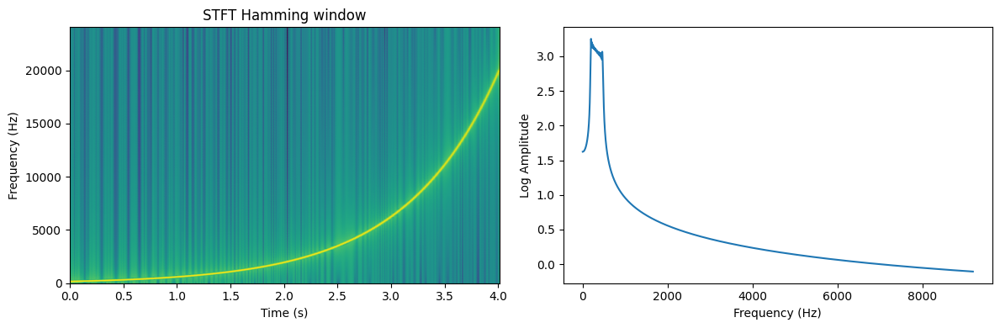

In [523]:

x = chirpy
dft_size=40000
maxfreq=10000

N = Fs*d  # 20 Hz sampling rate for 50 s signal
freqs, dft = get_dft(x,dft_size)
t, f, SFT, Sx = get_spectrogramme(Fs,x)
maxInd = np.int32(dft_size*(maxfreq/Fs))

fig1, ax1 = plt.subplots(1,2,figsize=(12., 4.),)  # enlarge plot a bit
ax1[0].set_title(rf"STFT Hamming window")
ax1[0].set_xlabel('Time (s)')
ax1[0].set_ylabel('Frequency (Hz)')

ax1[0].pcolormesh(t,f,np.log10(abs(Sx)), shading='gouraud', cmap='viridis')
ax1[1].plot(freqs[:maxInd], np.log10(dft[:maxInd]))

ax1[1].set_xlabel('Frequency (Hz)')
ax1[1].set_ylabel('Log Amplitude')
# Shade areas where window slices stick out to the side:
fig1.tight_layout()
plt.show()


Audio

In [524]:
from scipy.io.wavfile import read
audio_path = 'anechoic/Audio files/'
audio_files = ['0-glued.wav', '30-glued.wav', 'm60-01-glued.wav', '90-glued.wav', 'm120-glued.wav', '150-glued.wav', '180-glued.wav']
full_path = os.path.join(audio_path, audio_files[2])
Fs, data = read(full_path)
Audio(data, rate=Fs)

/var/folders/7r/hsw34hc51nb_tr19gdz3jbm80000gn/T/ipykernel_54487/273071946.py:5: WavFileWarning: Chunk (non-data) not understood, skipping it.
  Fs, data = read(full_path)


In [525]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import ShortTimeFFT
from scipy.signal.windows import gaussian
from scipy.signal import find_peaks

179994


/var/folders/7r/hsw34hc51nb_tr19gdz3jbm80000gn/T/ipykernel_54487/2071591655.py:17: WavFileWarning: Chunk (non-data) not understood, skipping it.
  a = read(full_path)


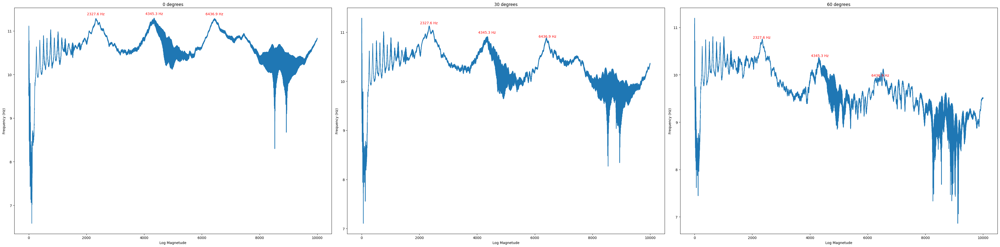

<Figure size 640x480 with 0 Axes>

[6436.938236   2327.61355443 4345.34967556]


In [526]:
print(len(data))
maxfreq = 10000
dft_size = 2**18
# Create angles for the titles
angles = [0, 30, 60]

# Create the figure and subplots
fig, axes = plt.subplots(1, 3, figsize=(40, 10))  # 1 row, 7 columns
maxInd = np.int32(dft_size*(maxfreq/Fs))
axes = axes.flatten()

# Plot data and set titles for the first 7 subplots
for i, angle in enumerate(angles):
    full_path = os.path.join(audio_path, audio_files[i])
    wavefile = load_sound(full_path)

    a = read(full_path)
    data  = np.array(a[1],dtype=float)
    freqs, dft = get_dft(data, dft_size, Fs,False)
    log_dft = np.log10(dft[:maxInd])

    axes[i].plot(freqs[:maxInd], log_dft)
    axes[i].set_title(f"{angle} degrees")
    axes[i].set_xlabel("Log Magnetude")
    axes[i].set_ylabel("Frequency (Hz)")
    if (i == 0):
        peaks, _ = find_peaks(log_dft, height=None, distance=1000)  # Adjust `distance` for peak separation
        top_peaks = peaks[np.argsort(log_dft[peaks])[-3:]]  # Get indices of the top 3 peaks
    # Add annotations for peak frequencies
    for peak in top_peaks:
        axes[i].annotate(f"{freqs[peak]:.1f} Hz", 
                         (freqs[peak], log_dft[peak]), 
                         textcoords="offset points", 
                         xytext=(0, 10), 
                         ha='center', color='red')
    

# Adjust layout and display the plot
plt.tight_layout()
plt.show()
# Adjust layout and display the plot
plt.tight_layout()
plt.show()
print(freqs[top_peaks])

/var/folders/7r/hsw34hc51nb_tr19gdz3jbm80000gn/T/ipykernel_54487/536089202.py:6: WavFileWarning: Chunk (non-data) not understood, skipping it.
  Fs, data = read(full_path)


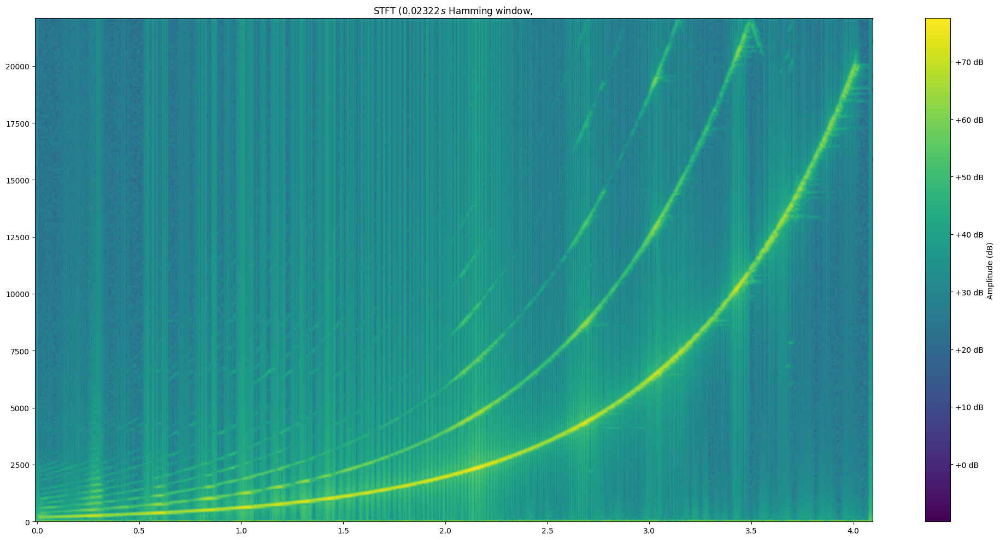

In [527]:
# Create the figure and subplots
fig, axes = plt.subplots(1,1, figsize=(20, 10))  # 1 row, 7 columns
im = []
full_path = os.path.join(audio_path, audio_files[i])

Fs, data = read(full_path)
t, f, SFT, Sx = get_spectrogramme(Fs,data,1024,1024,124)
axes.set_title(rf"STFT ({SFT.m_num*SFT.T:g}$\,s$ Hamming window, ")

pcm = axes.pcolormesh(t, f, 10 * np.log10(abs(Sx) + 1e-10), shading='gouraud', cmap='viridis')

cbar = fig.colorbar(pcm, ax=axes, format='%+2.0f dB')
cbar.set_label('Amplitude (dB)')

# Adjust layout and display the plot
fig.tight_layout()
plt.show()

/var/folders/7r/hsw34hc51nb_tr19gdz3jbm80000gn/T/ipykernel_54487/1481893709.py:12: WavFileWarning: Chunk (non-data) not understood, skipping it.
  Fs, data = read(full_path)


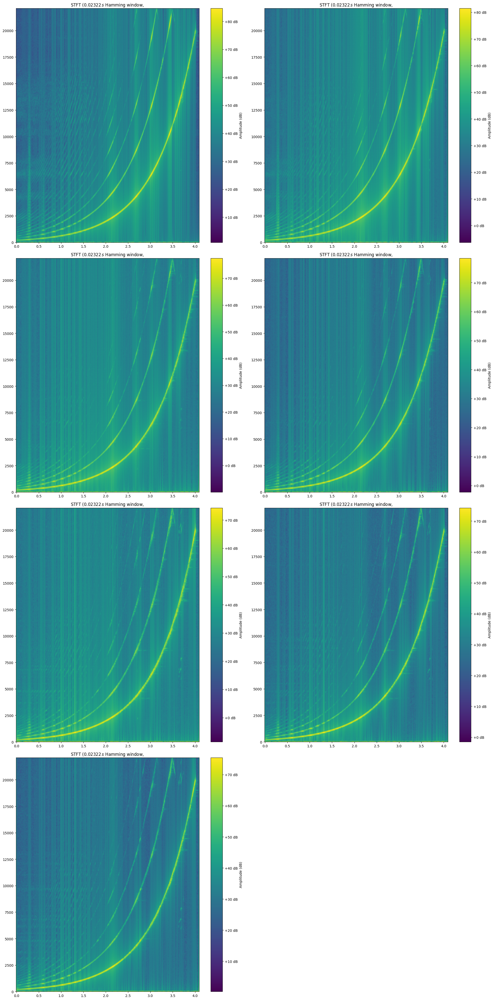

In [528]:


# Create angles for the titles
angles = [0, 30, 60, 90, 120, 150, 180]

# Create the figure and subplots
fig, axes = plt.subplots(4, 2, figsize=(20, 40))  # 1 row, 7 columns
axes = axes.flatten()
im = []
# Plot data and set titles for the first 7 subplots
for i, angle in enumerate(angles):
    full_path = os.path.join(audio_path, audio_files[i])

    Fs, data = read(full_path)
    t, f, SFT, Sx = get_spectrogramme(Fs,data,1024,1024,124)
    axes[i].set_title(rf"STFT ({SFT.m_num*SFT.T:g}$\,s$ Hamming window, ")

    pcm = axes[i].pcolormesh(t, f, 10 * np.log10(abs(Sx) + 1e-10), shading='gouraud', cmap='viridis')
 
    cbar = fig.colorbar(pcm, ax=axes[i], format='%+2.0f dB')
    cbar.set_label('Amplitude (dB)')
# Hide the last subplot as it remains empty
axes[-1].axis("off")

# Adjust layout and display the plot
fig.tight_layout()
plt.show()

Pour avoir l'amplitude qui correspond à il suffit de prendre l'index maximale pour une fréquence donnée : 

In [529]:

# Plot data and set titles for the first 7 subplots
p = np.zeros(len(audio_files))
def get_power(s):
    return np.sum((s/len(s))**2, 0)
for i, angle in enumerate(angles):
    full_path = os.path.join(audio_path, audio_files[i])
    wavefile = load_sound(full_path)
    Fs, data = read(full_path)
    p[i] = get_power(data)
print(p)

[8.54429559e+10 1.82356304e+10 2.24354910e+09 3.02321393e+09
 9.38006693e+08 7.85474988e+08 1.08523710e+09]


/var/folders/7r/hsw34hc51nb_tr19gdz3jbm80000gn/T/ipykernel_54487/1801043038.py:8: WavFileWarning: Chunk (non-data) not understood, skipping it.
  Fs, data = read(full_path)


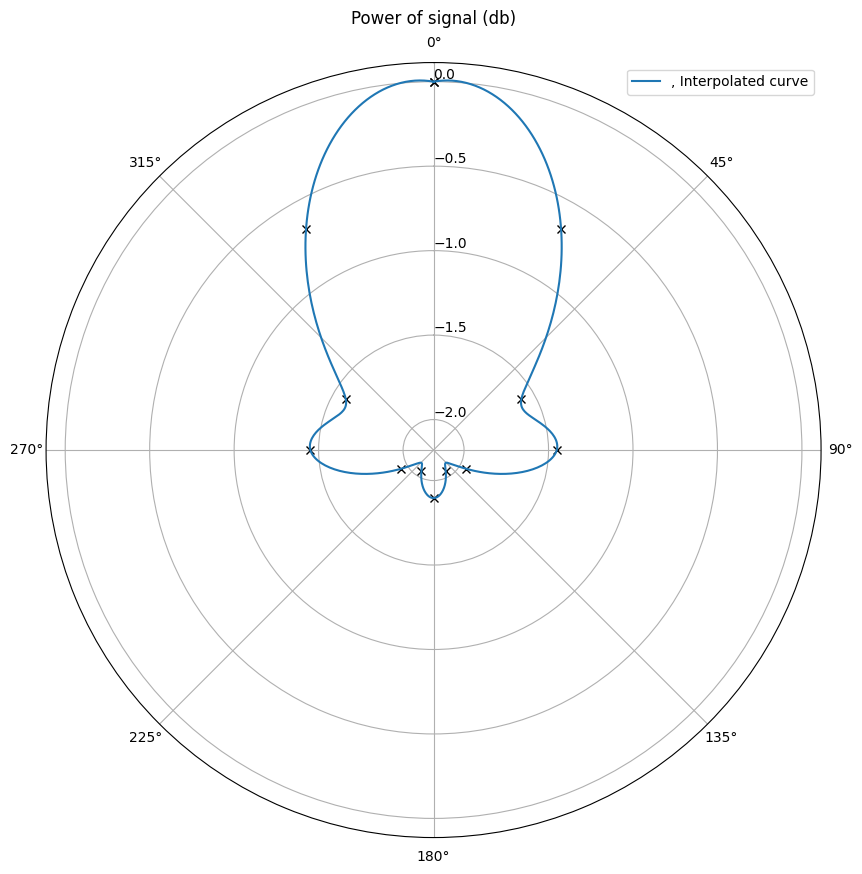

In [530]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d

def plot_polar(datas, title, legends):
    angles = np.linspace(0, 2 * np.pi, len(audio_files)*2-1)  # Angles from 0 to 360 degrees

    # Plot in polar coordinates
    fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(10, 20))
    for k,data in enumerate(datas):
        data2 = np.concat([data[:-1], data[::-1]])
        # Plot directivity pattern (dB scale)
        ax.plot(angles, data2, 'x', color="black")

        angles_dense = np.linspace(0, 2 * np.pi, 500)  # Dense angles for smooth curve
        interp_func = interp1d(angles, data2, kind="cubic")  # Cubic interpolation
        data_smooth = interp_func(angles_dense)
        if (k==0):
            ax.plot(angles_dense, data_smooth, '-',label=f"{legends[k]}, Interpolated curve")
        else:
            ax.plot(angles_dense, data_smooth, '-', label=f"{legends[k]}")
    # Set angular ticks in degrees
    ax.set_theta_zero_location("N")  # Zero degrees at the top
    ax.set_theta_direction(-1)       # Angles increase clockwise
    #ax.set_xticks(np.radians([0, 45, 90, 135, 180, 225, 270, 315]))  # Degrees
    # Set radial axis (dB scale)
    ax.set_rlabel_position(0)  # Radial labels at 0 degrees

    # Add title and legend
    ax.set_title(title, va='bottom')
    ax.legend(loc="upper right")
    plt.show()

plot_polar([np.log10(p/p[0])], "Power of signal (db)", [""])

In [531]:
def magnetude(audio, Fs, timing_in_sample, window_size):
    corresponding_audio_samples = audio[np.int64(timing_in_sample-(window_size+1)//2):np.int64(timing_in_sample+(window_size+1)//2)]
    r = get_power(corresponding_audio_samples)

    return r

def get_corresponding_timing(frequency, audio_length, f_min=200, f_max=20000):
    return audio_length*np.log(frequency/f_min)/np.log(f_max/f_min)



/var/folders/7r/hsw34hc51nb_tr19gdz3jbm80000gn/T/ipykernel_54487/1805014624.py:14: WavFileWarning: Chunk (non-data) not understood, skipping it.
  Fs, data = read(full_path)


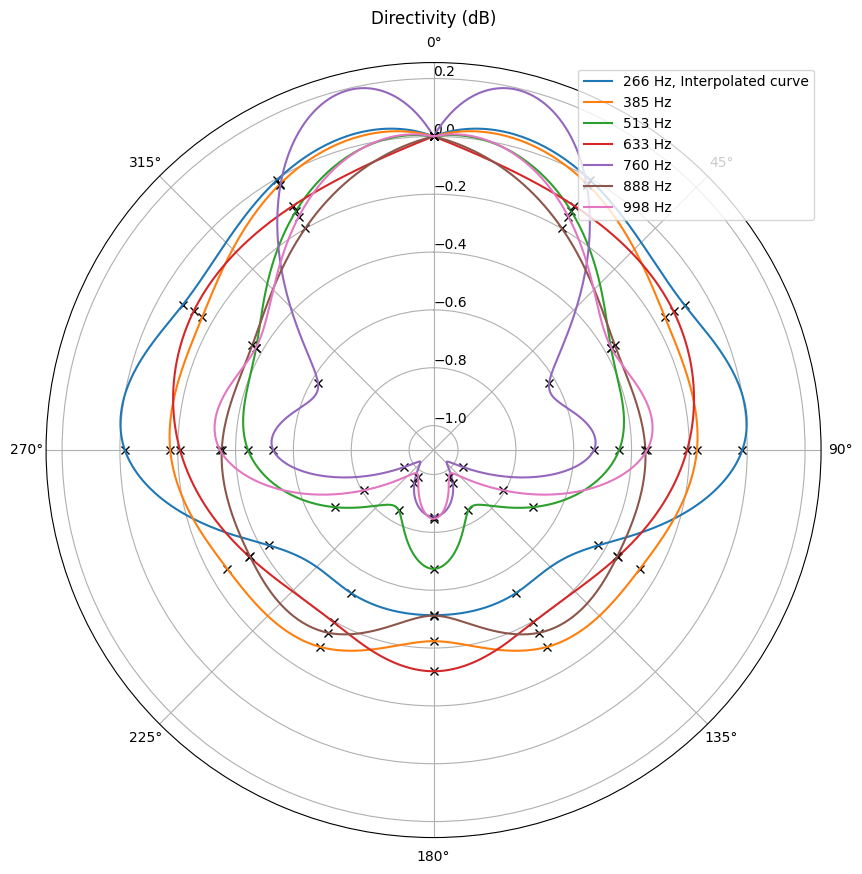

In [533]:
frequencies = np.array([266, 385,513, 633, 760,  888, 998])
p = np.zeros((len(frequencies),len(audio_files)))
angles = ["0°","30°","60°","90°","120°","150°","180°"]  # Angles from 0 to 360 degrees
def format_frequencies_with_hz(frequencies):
    """Convert an array of frequencies to a list of strings with ' Hz' appended."""
    return [f"{freq} Hz" for freq in frequencies]

frequency_labels = format_frequencies_with_hz(frequencies)

for j,f in enumerate(frequencies):
    for i, angle in enumerate(angles):
        full_path = os.path.join(audio_path, audio_files[i])
        wavefile = load_sound(full_path)
        Fs, data = read(full_path)
        index = get_corresponding_timing(f, len(data))
        p[j][i] = magnetude(data, Fs, index, 1000)
plot_polar(np.log10(p/p[:,0][:, np.newaxis]),"Directivity (dB)", frequency_labels)

/var/folders/7r/hsw34hc51nb_tr19gdz3jbm80000gn/T/ipykernel_54487/642384260.py:13: WavFileWarning: Chunk (non-data) not understood, skipping it.
  Fs, data = read(full_path)


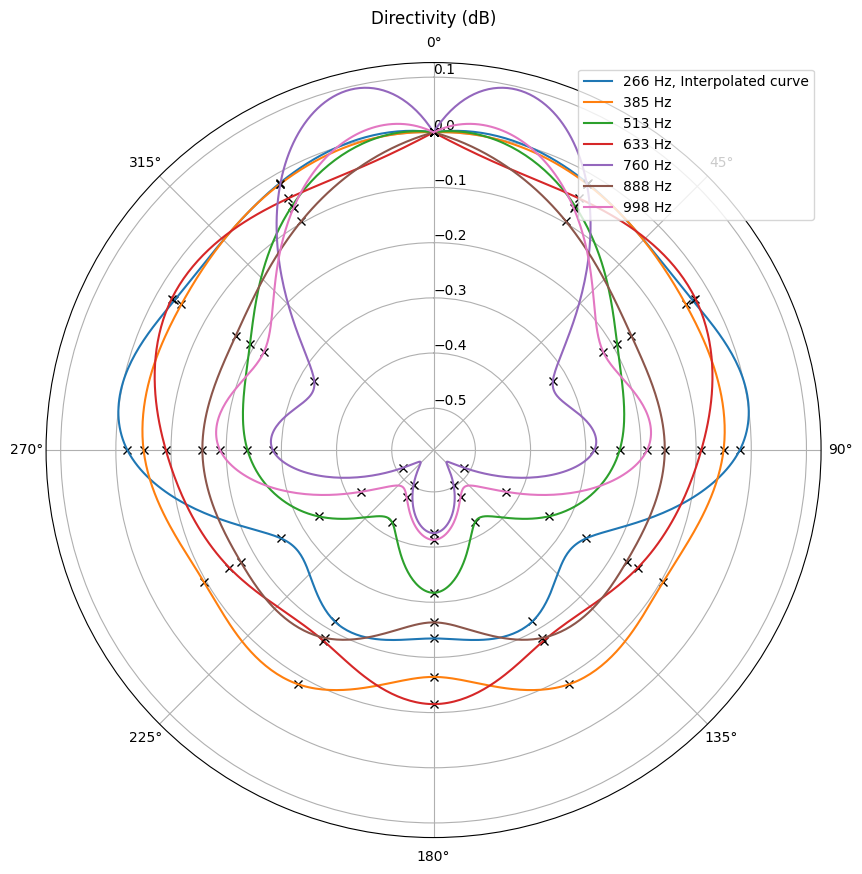

In [534]:
frequencies = np.array([266, 385,513, 633, 760,  888, 998])
p = np.zeros((len(frequencies),len(audio_files)))
angles = ["0°","30°","60°","90°","120°","150°","180°"]  # Angles from 0 to 360 degrees
def format_frequencies_with_hz(frequencies):
    """Convert an array of frequencies to a list of strings with ' Hz' appended."""
    return [f"{freq} Hz" for freq in frequencies]

frequency_labels = format_frequencies_with_hz(frequencies)

for i, angle in enumerate(angles):
    full_path = os.path.join(audio_path, audio_files[i])
    wavefile = load_sound(full_path)
    Fs, data = read(full_path)
    freqs, dft = get_dft(data,dft_size)
    for j,f in enumerate(frequencies):
        index = get_corresponding_timing(f, len(data))
        p[j][i] = dft[np.int32(dft_size*(f/Fs))]

plot_polar(np.log10(p/p[:,0][:, np.newaxis]),"Directivity (dB)", frequency_labels)

In [506]:
maxes = np.zeros(7)

for i, angle in enumerate(angles):
    full_path = os.path.join(audio_path, audio_files[i])
    wavefile = load_sound(full_path)
    Fs, data = read(full_path)
    maxes[i] = np.max(data)
print(maxes)

[1.00905498e+09 3.62414080e+08 1.58218496e+08 1.54534400e+08
 6.05962240e+07 5.37827840e+07 7.93244160e+07]


/var/folders/7r/hsw34hc51nb_tr19gdz3jbm80000gn/T/ipykernel_54487/961120649.py:6: WavFileWarning: Chunk (non-data) not understood, skipping it.
  Fs, data = read(full_path)


In [507]:
audio_path = 'anechoic/Audio files/'
audio_files = ['0.wav', '30.wav', '60.wav', '90.wav', '120-01.wav', '150.wav', '180.wav']

full_path = os.path.join(audio_path, "musique.wav")
wavefile = load_sound(full_path)
Fs = wavefile.getparams().nchannels
Audio(full_path, rate=Fs)

Sabine method 1

In [508]:
from scipy.signal import convolve
import numpy as np
import matplotlib.pyplot as plt

def generate_white_noise(duration, sampling_rate, amplitude=1.0):
    """
    Generate white noise.

    Parameters:
    - duration (float): Duration of the noise in seconds.
    - sampling_rate (int): Sampling rate in Hz.
    - amplitude (float): Amplitude of the noise (default is 1.0).

    Returns:
    - numpy.ndarray: Array containing the white noise.
    """
    num_samples = int(duration * sampling_rate)
    # Generate random samples from a normal distribution
    noise = np.random.normal(0, amplitude, num_samples)

    return noise

Fs = 44100

def sabine_reverb(T60,duration, Fs):
    noise = generate_white_noise(duration, Fs)
    t = np.linspace(0,duration,int(duration*Fs))
    decroiss = np.exp(-t/T60)
    return decroiss*noise


def early_reflexions(distances, duration, Fs):
    times = distances/340
    inpulse_response = np.zeros(int(duration * Fs))
    indices = np.int32(times*Fs)
    print(indices)
    inpulse_response[indices] = np.ones(times.shape)
    return inpulse_response

def poisson_reverb(T60,duration, Fs):
    noise = generate_white_noise(duration, Fs)
    t = np.linspace(0,duration,int(duration*Fs))
    
    decroiss = np.exp(-t/T60)
    return decroiss*noise

def apply_impulse_response(audio, impulse_response):
    """
    Apply an impulse response to an audio signal using convolution.
    
    Parameters:
    - audio (numpy.ndarray): Input audio signal.
    - impulse_response (numpy.ndarray): Impulse response of the room.
    
    Returns:
    - numpy.ndarray: Audio signal after applying the impulse response.
    """

    convolved_signal = convolve(audio, impulse_response, mode='full')

    return convolved_signal


#ImpulsResponse = sabine_reverb(0.5,20, 44100)
ImpulsResponse = early_reflexions(np.array([50, 20]), 20, 44100)
audio_path = 'anechoic/Audio files/'
full_path = os.path.join(audio_path, "musique.wav")

a = read(full_path)
data  = np.array(a[1],dtype=float)
audio2 = apply_impulse_response(data, ImpulsResponse)
Audio(audio2, rate=Fs)

[6485 2594]


/var/folders/7r/hsw34hc51nb_tr19gdz3jbm80000gn/T/ipykernel_54487/3666145239.py:69: WavFileWarning: Chunk (non-data) not understood, skipping it.
  a = read(full_path)


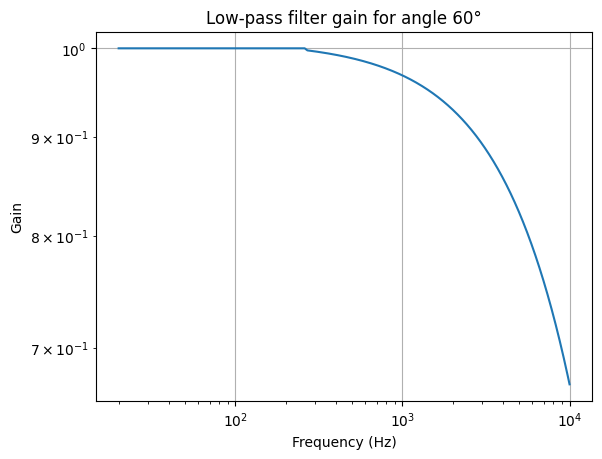

In [509]:
import numpy as np
import matplotlib.pyplot as plt

def low_pass_filter(frequencies, angle):
    # Define the parameters for the linear attenuation model
    f1, f2 = 266, 998  # Example frequencies
    att_f1, att_f2 = 0.02, 0.28  # Corresponding attenuations in dB at these frequencies

    # Calculate the slope (attenuation per Hz) based on the two points (f1, att_f1) and (f2, att_f2)
    slope = (att_f2 - att_f1) / (f2 - f1)

    # Create an array to store the attenuation values for each frequency
    attenuations = np.zeros_like(frequencies)

    # For each frequency, calculate the attenuation based on the linear model
    for i, f in enumerate(frequencies):
        if f < f1:
            attenuation = 0  # No attenuation below f1
        elif f >= f1 and f <= f2:
            # Linear interpolation between the two points
            attenuation = att_f1 + slope * (f - f1)
        else:
            # Attenuation for frequencies greater than f2 (increase linearly or keep constant)
            attenuation = att_f2 + slope * (f - f2)
        
        # Adjust for the angle (the effect of angle could be linear as well)
        attenuation *= angle / 60  # Assuming 60° corresponds to full attenuation effect

        attenuations[i] = attenuation

    # Apply the attenuation (in dB) to the signal, converting it to a gain factor
    gains = 10 ** (-attenuations / 20)

    return gains

# Example frequencies (Hz)
frequencies = np.linspace(20, 10000, 1000)

# Apply the low-pass filter for a specific angle (e.g., 60 degrees)
angle = 60
gains = low_pass_filter(frequencies, angle)

# Plot the resulting gain curve
plt.plot(frequencies, gains)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Gain')
plt.title(f'Low-pass filter gain for angle {angle}°')
plt.grid(True)
plt.show()

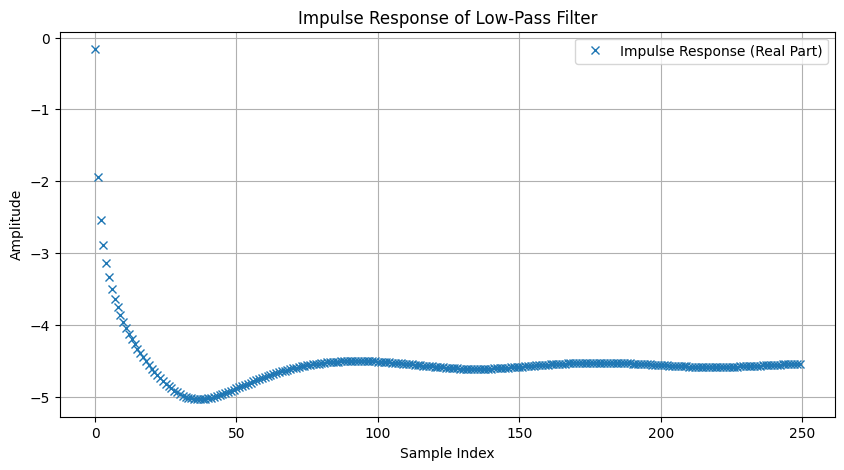

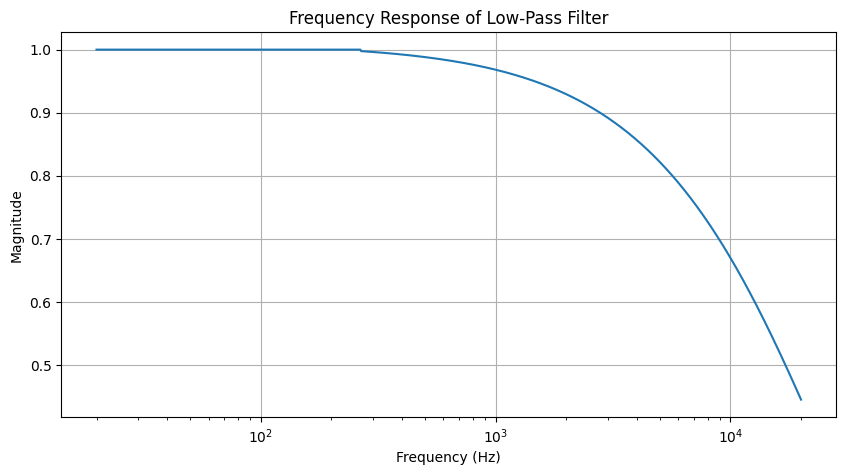

In [545]:
import numpy as np
import matplotlib.pyplot as plt

def low_pass_filter(frequencies, angle):
    # Define the parameters for the linear attenuation model
    f1, f2 = 266, 998  # Example frequencies
    att_f1, att_f2 = 0.02, 0.28  # Corresponding attenuations in dB at these frequencies

    # Calculate the slope (attenuation per Hz) based on the two points (f1, att_f1) and (f2, att_f2)
    slope = (att_f2 - att_f1) / (f2 - f1)

    # Create an array to store the attenuation values for each frequency
    attenuations = np.zeros_like(frequencies)

    # For each frequency, calculate the attenuation based on the linear model
    for i, f in enumerate(frequencies):
        if f < f1:
            attenuation = 0  # No attenuation below f1
        elif f >= f1 and f <= f2:
            # Linear interpolation between the two points
            attenuation = att_f1 + slope * (f - f1)
        else:
            # Attenuation for frequencies greater than f2 (increase linearly or keep constant)
            attenuation = att_f2 + slope * (f - f2)
        
        # Adjust for the angle (the effect of angle could be linear as well)
        attenuation *= angle / 60  # Assuming 60° corresponds to full attenuation effect

        attenuations[i] = attenuation

    # Apply the attenuation (in dB) to the signal, converting it to a gain factor
    gains = 10 ** (-attenuations / 20)

    return gains

# Example frequencies (Hz)
frequencies = np.linspace(20, 20000, 10000)

# Apply the low-pass filter for a specific angle (e.g., 60 degrees)
angle = 60
gains = low_pass_filter(frequencies, angle)

# Create a frequency response array with the same shape as the frequency bins
# The frequency response should be real-valued and corresponding to the gains
frequency_response = gains

# Compute the impulse response using the Inverse FFT (IFFT)
# First, we need to build the frequency response into a complex array with magnitude and phase
# For simplicity, let's assume phase = 0 for a real-valued filter (ideal for a simple low-pass)

# We will use the complex frequency response for the IFFT
complex_frequency_response = frequency_response * np.exp(1j * np.zeros_like(frequency_response))

# Perform the Inverse FFT
impulse_response = np.fft.ifft(complex_frequency_response)

filter_length = 250
# Plot the impulse response (real part)
plt.figure(figsize=(10, 5))
plt.plot(np.arange(filter_length),np.log10(np.real(impulse_response[:filter_length])), 'x', label="Impulse Response (Real Part)")
plt.xlabel('Sample Index')
plt.ylabel('Amplitude')
plt.title('Impulse Response of Low-Pass Filter')
plt.grid(True)
plt.legend()
plt.show()

# Optionally, plot the magnitude of the frequency response to visualize the filter's frequency response
plt.figure(figsize=(10, 5))
plt.plot(frequencies, frequency_response)
plt.xscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title('Frequency Response of Low-Pass Filter')
plt.grid(True)
plt.show()